### 이미지 로데이터 파일에서 데이터 추출

[1] 파일 입출력 방식

In [2]:
# with open() as ~

file_path = '../DATA/MNIST/t10k-images.idx3-ubyte'

In [3]:
# 파일 읽을 때 고려사항 => mode = br : 바이트 모드
with open(file_path, mode = 'br') as f:
    all_data = f.read()

In [6]:
print(type(all_data), len(all_data))
print(all_data[:10])

<class 'bytes'> 7840016
b"\x00\x00\x08\x03\x00\x00'\x10\x00\x00"


In [15]:
# 파일 읽을 때 고려사항 => mode = br : 바이트 모드
with open(file_path, mode = 'br') as f:
    
    magic_code = f.read(4)
    print(magic_code)

    data_length = f.read(4)
    print(data_length) 

    row = f.read(4)
    print(row)

    col = f.read(4)
    print(col)

b'\x00\x00\x08\x03'
b"\x00\x00'\x10"
b'\x00\x00\x00\x1c'
b'\x00\x00\x00\x1c'


[2] 파이썬의 byte 데이터 변환 모듈 struct 활용 <hr>

In [22]:
# 모듈 로딩
import os, struct

In [19]:
# 데이터 추출 및 저장 관련 변수
save_file = '../DATA/MNIST/mnist.csv'

In [35]:
# 데이터 추출 및 저장 관련 변수
# 학습용 : train.csv
# 테스트용 : test.csv
# 위치 : ../DATA/txt/

save_dir = '../DATA/MNIST/'
data_dir = '../DATA/MNIST/'
train_file = data_dir + 'train.csv'
test_file = data_dir + 'test.csv'

In [36]:
# 사용자 정의 함수
# 기능 : raw data 파일을 읽어서 csv 파일로 저장
# 함수명 : to_csv
# 매개변수 : 파일이름, 데이터수
# 반환값 : 파일 생성 여부, True/False

# 디버깅 출력 제어 플래그 변수
DEBUG = True

def to_csv(name, maxdata):

    # (1) CSV 형식으로 저장할 데이터 준비
    # 레이블 파일과 이미지 파일 열기
    lbl_f = open(data_dir + name + '-labels.idx1-ubyte', 'rb')
    img_f = open(data_dir + name + '-images.idx3-ubyte', 'rb')

    # CSV 파일 생성
    csv_f = open(save_dir + name + '.csv', 'w', encoding = 'utf-8')
    
    # 헤더 정보 읽기
    mag, lbl_count = struct.unpack('>II', lbl_f.read(8))
    mag, img_count = struct.unpack('>II', img_f.read(8))
    rows, cols = struct.unpack('>II', img_f.read(8))
    pixels = rows * cols

    if DEBUG:
        print('lbl_count {}, image_count {}'.format(lbl_count, img_count))
        print('rows {}, cols {}'.format(rows, cols))
    
    # (2) 이미지 데이터를 읽고 CSV로 저장
    res = []
    for idx in range(lbl_count):
        if idx > maxdata : break

        # 숫자 이미지 데이터가 의미하는 숫자값 읽기
        # 튜플 타입 리턴 => 1개 데이터 (value,)
        label = struct.unpack('B', lbl_f.read(1))[0]
        if DEBUG: print('label => {}'.format(label))
    
        # 이미지 데이터 읽기
        bdata = img_f.read(pixels)
        sdata = list(map(lambda n: str(n), bdata))  # 문자열로 변환
        if DEBUG: print('sdata => {}'.format(sdata))

        # csv 파일에 쓰기
        csv_f.write(str(label) + ',')  # 숫자 라벨 쓰기
        csv_f.write(','.join(sdata) + '\n')  #
    
    csv_f.close()
    lbl_f.close()
    img_f.close()

    # 생성된 파일 존재 여부 확인 후 반환
    return os.path.exists(save_dir + f'{name}.csv')

In [37]:
# 학습용 데이터 파일 생성
to_csv('train', 10000)

lbl_count 60000, image_count 60000
rows 28, cols 28
label => 5
sdata => ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '18', '18', '18', '126', '136', '175', '26', '166', '255', '247', '127', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '30', '36', '94', '154', '170

True

In [38]:
# 테스트용 데이터 파일 생성
to_csv('t10k', 1000)

lbl_count 10000, image_count 10000
rows 28, cols 28
label => 7
sdata => ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0

True

[3] 이미지 데이터 로딩 후 시각화

[3-1] 이미지 데이터 로딩 csv => DataFrame

In [57]:
import numpy as np
import pandas as pd

trainDF = pd.read_csv('../DATA/MNIST/train.csv', header = None)
trainDF.head()

,0,1,2,3,4,5,6,7,8,9,...,775,776,777,778,779,780,781,782,783,784
0,5,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [59]:
trainDF.shape

(10001, 785)

In [58]:
# 이미지 데이터와 라벨 분리
labels = trainDF[0]
img_data = trainDF.iloc[:, 1:]
labels.shape, img_data.shape, img_data[:3]


((10001,),
 (10001, 784),
    1    2    3    4    5    6    7    8    9    10   ...  775  776  777  778  \
 0    0    0    0    0    0    0    0    0    0    0  ...    0    0    0    0   
 1    0    0    0    0    0    0    0    0    0    0  ...    0    0    0    0   
 2    0    0    0    0    0    0    0    0    0    0  ...    0    0    0    0   
 
    779  780  781  782  783  784  
 0    0    0    0    0    0    0  
 1    0    0    0    0    0    0  
 2    0    0    0    0    0    0  
 
 [3 rows x 784 columns])

[3-2] 데이터 시각화

In [66]:
raw_img = img_data.iloc[0].values.reshape(28, 28)

type(raw_img), raw_img.shape, raw_img.ndim

(numpy.ndarray, (28, 28), 2)

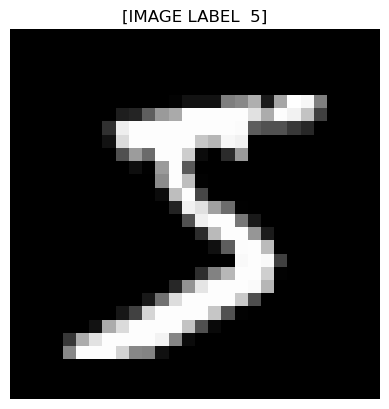

In [71]:
# 시각화
import matplotlib.pyplot as plt

plt.imshow(raw_img, cmap = 'gray')
plt.title(f'[IMAGE LABEL  {labels[0]}]')
plt.axis('off')
plt.show()

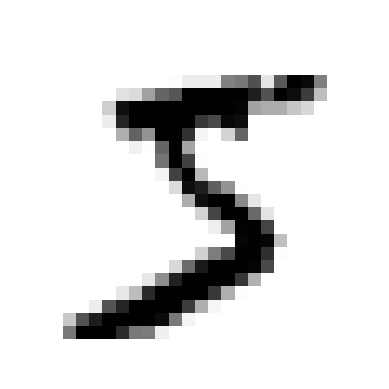

In [61]:
# 참고
import matplotlib.pyplot as plt

def plot_digit(image_data):
    image = image_data.reshape(28, 28)  # 1D 이미지 데이터를 2D 이미지 데이터로 변환
    plt.imshow(image, cmap = 'binary')
    plt.axis('off')

some_digit = img_data.iloc[0].values
plot_digit(some_digit)
plt.show()